In [ ]:
# Download data from github

import os
from urllib.request import urlretrieve

BASE_URL = "https://raw.githubusercontent.com/DeepTrackAI/DeepLearningCrashCourse/refs/heads/main/Ch03_CNN/ec03_D_style_transfer"
FILES = ['lizard.png', 'neuraltissue_with_colorlabels.png']

for name in FILES:
    url = f"{BASE_URL}/{name}"
    if not os.path.exists(name):
        print(f"Downloading {name}")
        urlretrieve(url, name)
    else:
        print(f"Already exists: {name}")


# Transferring Image Styles


<div style="background-color: #f0f8ff; border: 2px solid #4682b4; padding: 10px;">
<a href="https://colab.research.google.com/github/noctonic/DeepLearningCrashCourse/blob/main/Ch03_CNN/ec03_D_style_transfer/style_transfer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>
<strong>If using Colab/Kaggle:</strong> You need to copy the "lizard.png" and "neuraltissue_with_colorlabels.png" files from the
<a href="https://github.com/DeepTrackAI/DeepLearningCrashCourse/tree/main/Ch03_CNN/ec03_D_style_transfer">notebook folder</a> in GitHub to the Colab/Kaggle work directory.
</div>

This notebook provides you with a complete code example that loads the content image, the style image, and the VGG16 pre-trained neural network, and uses them to transfer the style to the image.

<div style="background-color: #f0f8ff; border: 2px solid #4682b4; padding: 10px;">
<strong>Note:</strong> This notebook contains the Code Example 3-D from the book  

**Deep Learning Crash Course**  
Giovanni Volpe, Benjamin Midtvedt, Jesús Pineda, Henrik Klein Moberg, Harshith Bachimanchi, Joana B. Pereira, Carlo Manzo  
No Starch Press, San Francisco (CA), 2026  
ISBN-13: 9781718503922  

[https://nostarch.com/deep-learning-crash-course](https://nostarch.com/deep-learning-crash-course)

You can find the other notebooks on the [Deep Learning Crash Course GitHub page](https://github.com/DeepTrackAI/DeepLearningCrashCourse).
</div>

## Loading the Content and Style Images

Load a crop of the content image ...

This image is sourced from the Drosophila ssTEM dataset, which is publicly available on Figshare: [Segmented anisotropic ssTEM dataset of neural tissue](https://figshare.com/articles/dataset/Segmented_anisotropic_ssTEM_dataset_of_neural_tissue/856713). This dataset provides a detailed view of neural tissue, aiding in the study of neural structures and patterns. The image can also be downloaded from the corresponding GitHub repository at [this link](http://github.com/unidesigner/groundtruth-drosophila-vnc), which offers additional resources and information related to the Drosophila ssTEM dataset.

In [1]:
from PIL import Image

content = (Image.open("neuraltissue_with_colorlabels.png").convert("RGB")
           .crop((100, 170, 100 + 256, 170 + 256)))

... plot it ...

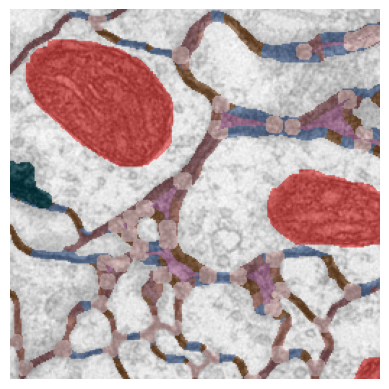

In [2]:
import matplotlib.pyplot as plt

plt.imshow(content)
plt.axis("off")
plt.show()

... load the style image ...

You'll use the style of the _trencadis_ lizard by Antoni Gaudi  in Parc Guell (Barcelona).

In [3]:
style = Image.open("lizard.png").convert("RGB").resize((256, 256))

... and plot it.

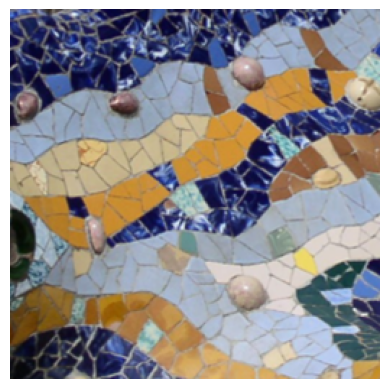

In [4]:
plt.imshow(style)
plt.axis("off")
plt.show()

## Loading a Pre-Trained Neural Network

Import the VGG16 model, a pre-trained neural network known for its proficiency in image recognition tasks ...

In [5]:
from torchvision.models import vgg16, VGG16_Weights

model = vgg16(weights=VGG16_Weights.IMAGENET1K_V1)
model.eval()
model.requires_grad_(False)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

... and print it.

In [6]:
print(model)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

Define some variables with the mean and standard deviation values specific to the ImageNet dataset’s color channels.

In [7]:
import numpy as np
import torch

mean = np.array([0.485, 0.456, 0.406], dtype=np.float32)
std = np.array([0.229, 0.224, 0.225], dtype=np.float32)

low = torch.tensor((- mean / std).reshape(1, -1, 1, 1))
high = torch.tensor(((1 - mean) / std).reshape(1, -1, 1, 1))

## Implementing Style Transfer

Implement a function to calculate the Gram matrix between all the activations of a specific layer ...

In [8]:
from torch import bmm

def gram(tensor):
    """Gram matrix."""
    batch_size, num_channels, height, width = tensor.size()
    features = tensor.view(batch_size, num_channels, height * width)
    gram_matrix = bmm(features, features.transpose(1, 2)) / (height * width)
    return gram_matrix

... define functions to to convert an image to a tensor, and vice versa ...

In [9]:
import torchvision.transforms as tt

def image_to_tensor(im, mean, std):
    """Convert image to tensor."""
    normalize = tt.Compose([tt.ToTensor(), tt.Normalize(mean, std)])
    return normalize(im).unsqueeze(0).requires_grad_(True)

def tensor_to_image(image, mean, std):
    """Convert tensor to image."""
    denormalize = tt.Normalize(mean=- mean / std, std=1 / std)
    im_array = denormalize(image.data.clone().detach().squeeze()).numpy()
    im_array = np.clip(im_array.transpose(1, 2, 0) * 255, 0, 255)
    im_array = im_array.astype(np.uint8)
    return Image.fromarray(im_array, "RGB")

... define a context manager class ...

In [10]:
class Fwd_Hooks():
    """Forward hooks."""

    def __init__(self, layers):
        """Initialize forward hooks."""
        self.hooks, self.activations_list = [], []
        for layer in layers:
            self.hooks.append(layer.register_forward_hook(self.hook_func))

    def hook_func(self, layer, input, output):
        """Save activations."""
        self.activations_list.append(output)

    def __enter__(self, *args):
        """Enter context management."""
        return self

    def __exit__(self, *args):
        """Exit context management and remove hooks."""
        for hook in self.hooks:
            hook.remove()

... and define a function to implement style transfer.

In [11]:
def style_transfer(image, content, style, content_layers, style_layers,
                   lr=1, iter_num=100, beta=1e3):
    """Perform style transfer."""
    mean = np.array([0.485, 0.456, 0.406], dtype=np.float32)
    std = np.array([0.229, 0.224, 0.225], dtype=np.float32)

    image_tensor = image_to_tensor(image, mean, std)

    with Fwd_Hooks(content_layers) as fh:
        _ = model(image_to_tensor(content, mean, std))
    con_activ_list = [activ.detach() for activ in fh.activations_list]

    with Fwd_Hooks(style_layers) as fh:
        _ = model(image_to_tensor(style, mean, std))
    target_gram_list = [gram(activ.detach()) for activ in fh.activations_list]

    optimizer = torch.optim.LBFGS([image_tensor], lr=lr)
    mse_loss = torch.nn.MSELoss(reduction="sum")

    def closure():
        """Closure function for the optimizer."""
        optimizer.zero_grad()

        with Fwd_Hooks(content_layers) as fh:
            _ = model(image_tensor)
        im_con_activ_list = fh.activations_list

        content_loss = 0
        for im_con_activ, con_activ in zip(im_con_activ_list, con_activ_list):
            num_feats = im_con_activ.shape[1]
            content_loss += mse_loss(im_con_activ, con_activ) / num_feats ** 2
        content_loss = content_loss / len(im_con_activ_list)

        with Fwd_Hooks(style_layers) as fh:
            _ = model(image_tensor)
        im_gram_list = [gram(activ) for activ in fh.activations_list]

        style_loss = 0
        for im_gram, target_gram in zip(im_gram_list, target_gram_list):
            num_feats = im_gram.shape[1]
            style_loss += mse_loss(im_gram, target_gram) / num_feats ** 2
        style_loss = style_loss / len(im_gram_list)

        print(f"content_loss={content_loss} style_loss={style_loss}")

        total_loss = content_loss + beta * style_loss
        total_loss.backward()
        return total_loss

    for i in range(iter_num):
        print(f"iteration {i}")
        optimizer.step(closure)

        plt.imshow(tensor_to_image(image_tensor, mean, std))
        plt.title(f"Iteration {i}")
        plt.axis("off")
        plt.show()

## Transferring the Style of an Image to Another Image

iteration 0
content_loss=0.0 style_loss=1.904022216796875
content_loss=2.2325605186779285e-06 style_loss=1.903765082359314
content_loss=50.94096374511719 style_loss=1.256737232208252
content_loss=71.9765853881836 style_loss=0.8719501495361328
content_loss=98.09257507324219 style_loss=0.6601136922836304
content_loss=103.69862365722656 style_loss=0.5311434864997864
content_loss=116.78274536132812 style_loss=0.4235871434211731
content_loss=139.75015258789062 style_loss=0.3531608581542969
content_loss=134.07814025878906 style_loss=0.3257579207420349
content_loss=137.69540405273438 style_loss=0.292462021112442
content_loss=144.32125854492188 style_loss=0.2589743733406067
content_loss=149.62591552734375 style_loss=0.2305707186460495
content_loss=162.9700164794922 style_loss=0.2055056095123291
content_loss=162.5406036376953 style_loss=0.19190406799316406
content_loss=166.72146606445312 style_loss=0.17709560692310333
content_loss=169.4259490966797 style_loss=0.16421031951904297
content_loss=17

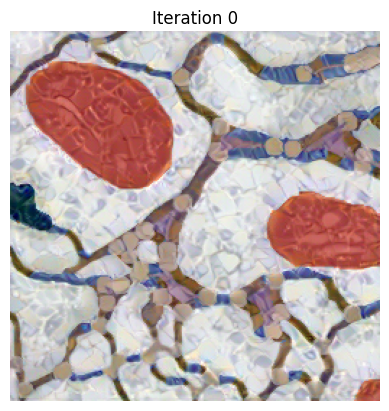

iteration 1
content_loss=193.63031005859375 style_loss=0.11301638185977936
content_loss=191.00653076171875 style_loss=0.12866702675819397
content_loss=197.62286376953125 style_loss=0.10344024002552032
content_loss=198.51634216308594 style_loss=0.10064537823200226
content_loss=200.45474243164062 style_loss=0.09756532311439514
content_loss=204.8618927001953 style_loss=0.09151075780391693
content_loss=205.24276733398438 style_loss=0.08828742802143097
content_loss=207.28346252441406 style_loss=0.08401796966791153
content_loss=211.6382598876953 style_loss=0.07904158532619476
content_loss=212.81704711914062 style_loss=0.07710902392864227
content_loss=216.1221923828125 style_loss=0.07449303567409515
content_loss=217.2612762451172 style_loss=0.07099217921495438
content_loss=221.0899658203125 style_loss=0.06646494567394257
content_loss=219.60047912597656 style_loss=0.06567443162202835
content_loss=222.5582275390625 style_loss=0.06450648605823517
content_loss=223.76828002929688 style_loss=0.0620

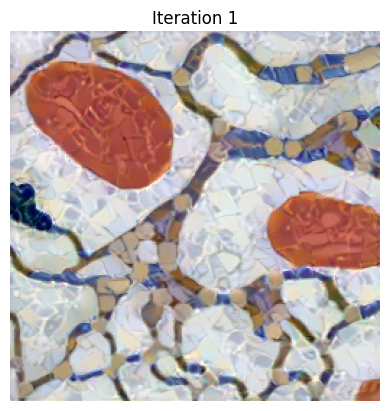

iteration 2
content_loss=229.268798828125 style_loss=0.05257400870323181
content_loss=231.0059814453125 style_loss=0.05100065469741821
content_loss=232.47451782226562 style_loss=0.04976627975702286
content_loss=232.73236083984375 style_loss=0.04867604374885559
content_loss=234.3578643798828 style_loss=0.047277070581912994
content_loss=234.57350158691406 style_loss=0.0459359847009182
content_loss=235.91465759277344 style_loss=0.043904419988393784
content_loss=238.34747314453125 style_loss=0.04229506477713585
content_loss=235.40130615234375 style_loss=0.046122293919324875
content_loss=238.43325805664062 style_loss=0.04140684753656387
content_loss=238.7708282470703 style_loss=0.04096461459994316
content_loss=236.71841430664062 style_loss=0.04543372243642807
content_loss=240.3189239501953 style_loss=0.0396902896463871
content_loss=240.54241943359375 style_loss=0.03910469263792038
content_loss=239.52835083007812 style_loss=0.04154474288225174
content_loss=241.44073486328125 style_loss=0.037

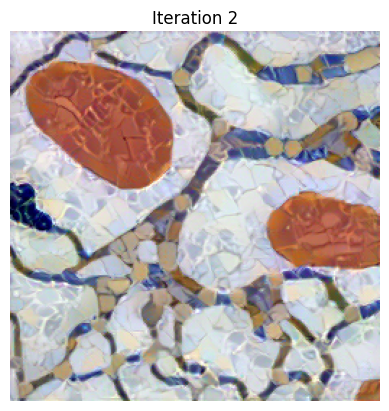

iteration 3
content_loss=241.0454559326172 style_loss=0.04105009883642197
content_loss=244.50970458984375 style_loss=0.033841874450445175
content_loss=244.94393920898438 style_loss=0.03327309712767601
content_loss=241.13038635253906 style_loss=0.040010787546634674
content_loss=245.79737854003906 style_loss=0.03215300291776657
content_loss=246.0642547607422 style_loss=0.0316375307738781
content_loss=243.42755126953125 style_loss=0.036840349435806274
content_loss=246.68223571777344 style_loss=0.030568543821573257
content_loss=246.97982788085938 style_loss=0.030095834285020828
content_loss=244.55062866210938 style_loss=0.03529955819249153
content_loss=247.79586791992188 style_loss=0.029112819582223892
content_loss=248.12757873535156 style_loss=0.02867279015481472
content_loss=246.0782928466797 style_loss=0.03291697055101395
content_loss=248.8957977294922 style_loss=0.02772499993443489
content_loss=249.24978637695312 style_loss=0.027299653738737106
content_loss=246.72610473632812 style_los

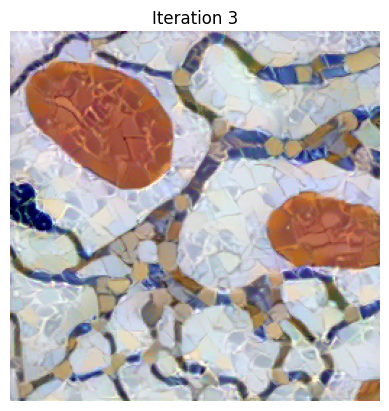

iteration 4
content_loss=251.58465576171875 style_loss=0.0248255655169487
content_loss=249.88229370117188 style_loss=0.02818748913705349
content_loss=252.31399536132812 style_loss=0.024054789915680885
content_loss=252.66390991210938 style_loss=0.023718319833278656
content_loss=250.8737030029297 style_loss=0.02742854878306389
content_loss=253.36317443847656 style_loss=0.023013025522232056
content_loss=253.68495178222656 style_loss=0.02268892712891102
content_loss=251.9142303466797 style_loss=0.02686208486557007
content_loss=254.37245178222656 style_loss=0.02203037217259407
content_loss=254.69752502441406 style_loss=0.02172379568219185
content_loss=253.0211181640625 style_loss=0.02503023110330105
content_loss=255.37191772460938 style_loss=0.021105248481035233
content_loss=255.6881561279297 style_loss=0.020824288949370384
content_loss=253.9930419921875 style_loss=0.02343716099858284
content_loss=256.2220153808594 style_loss=0.02025722526013851
content_loss=256.5384826660156 style_loss=0.0

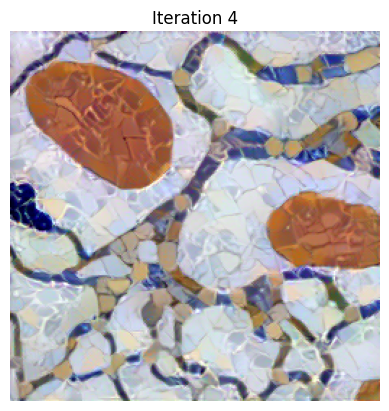

iteration 5
content_loss=257.90484619140625 style_loss=0.018712636083364487
content_loss=258.1176452636719 style_loss=0.018492672592401505
content_loss=256.178955078125 style_loss=0.021060669794678688
content_loss=258.5952453613281 style_loss=0.018006306141614914
content_loss=258.7372741699219 style_loss=0.01777968741953373
content_loss=256.3963623046875 style_loss=0.020797135308384895
content_loss=259.07305908203125 style_loss=0.0173482783138752
content_loss=259.1517333984375 style_loss=0.017140157520771027
content_loss=256.7033386230469 style_loss=0.019251083955168724
content_loss=259.34075927734375 style_loss=0.0167317483574152
content_loss=259.37701416015625 style_loss=0.016539379954338074
content_loss=257.8595886230469 style_loss=0.017650021240115166
content_loss=259.6293640136719 style_loss=0.016126533970236778
content_loss=259.6732482910156 style_loss=0.015956182032823563
content_loss=257.9653015136719 style_loss=0.017080767080187798
content_loss=259.9607238769531 style_loss=0.0

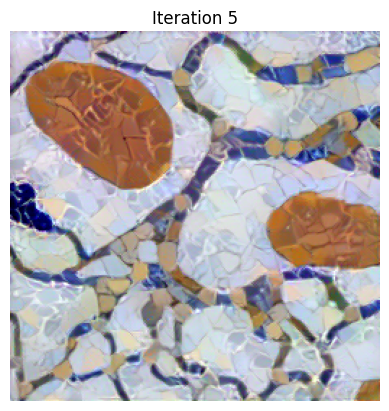

iteration 6
content_loss=257.68914794921875 style_loss=0.017094895243644714
content_loss=260.5669860839844 style_loss=0.01456115860491991
content_loss=260.56170654296875 style_loss=0.014417040161788464
content_loss=259.46820068359375 style_loss=0.015277190133929253
content_loss=260.5921936035156 style_loss=0.01408839225769043
content_loss=260.7387390136719 style_loss=0.0139481695368886
content_loss=258.1385192871094 style_loss=0.015470932237803936
content_loss=261.0301513671875 style_loss=0.013679763302206993
content_loss=261.071533203125 style_loss=0.013556405901908875
content_loss=259.6631774902344 style_loss=0.0144110769033432
content_loss=261.1411437988281 style_loss=0.013264814391732216
content_loss=261.2246398925781 style_loss=0.013142546638846397
content_loss=259.24981689453125 style_loss=0.01467569638043642
content_loss=261.4898376464844 style_loss=0.012894632294774055
content_loss=261.51513671875 style_loss=0.012779591605067253
content_loss=260.3177490234375 style_loss=0.01343

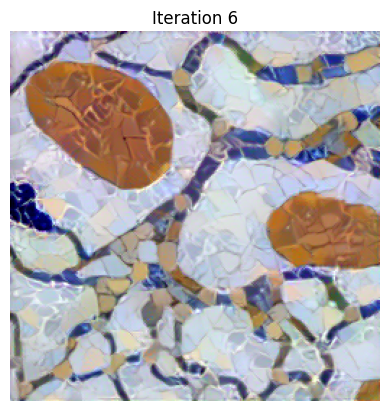

iteration 7
content_loss=261.92950439453125 style_loss=0.012082792818546295
content_loss=260.70489501953125 style_loss=0.01275031827390194
content_loss=262.0222473144531 style_loss=0.011856608092784882
content_loss=262.0133361816406 style_loss=0.011762404814362526
content_loss=260.5941467285156 style_loss=0.012311499565839767
content_loss=262.160400390625 style_loss=0.01154557429254055
content_loss=262.090087890625 style_loss=0.011459006927907467
content_loss=261.21612548828125 style_loss=0.011641139164566994
content_loss=262.02392578125 style_loss=0.011227965354919434
content_loss=262.1022033691406 style_loss=0.011146069504320621
content_loss=260.5845031738281 style_loss=0.011518272571265697
content_loss=262.33380126953125 style_loss=0.010923361405730247
content_loss=262.2723693847656 style_loss=0.010846917517483234
content_loss=261.2244567871094 style_loss=0.011032404378056526
content_loss=262.2104797363281 style_loss=0.01066045742481947
content_loss=262.22906494140625 style_loss=0.0

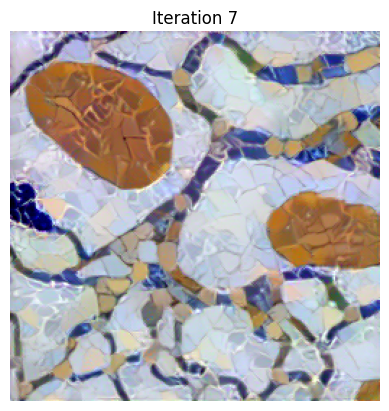

iteration 8
content_loss=262.3116455078125 style_loss=0.010192276909947395
content_loss=262.2699279785156 style_loss=0.01012442260980606
content_loss=261.1362609863281 style_loss=0.010329270735383034
content_loss=262.3504638671875 style_loss=0.009960848838090897
content_loss=262.2843933105469 style_loss=0.00990112591534853
content_loss=261.41387939453125 style_loss=0.010010610334575176
content_loss=262.2497863769531 style_loss=0.009736830368638039
content_loss=262.2662353515625 style_loss=0.009682176634669304
content_loss=260.8041076660156 style_loss=0.010263067670166492
content_loss=262.45745849609375 style_loss=0.009528497233986855
content_loss=262.4223937988281 style_loss=0.009466566145420074
content_loss=261.3778991699219 style_loss=0.009655984118580818
content_loss=262.3804626464844 style_loss=0.009323572739958763
content_loss=262.3516845703125 style_loss=0.009268799796700478
content_loss=261.10748291015625 style_loss=0.009564969688653946
content_loss=262.474609375 style_loss=0.00

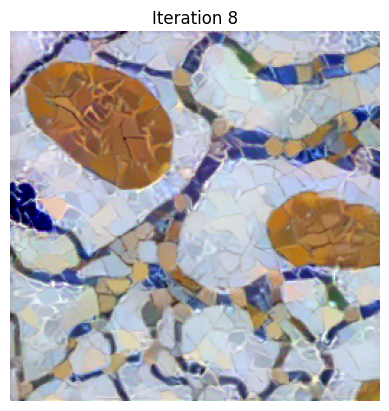

iteration 9
content_loss=261.0539245605469 style_loss=0.009315887466073036
content_loss=262.523681640625 style_loss=0.00879736989736557
content_loss=262.50433349609375 style_loss=0.008749967440962791
content_loss=261.2823791503906 style_loss=0.009022386744618416
content_loss=262.461181640625 style_loss=0.008633166551589966
content_loss=262.4304504394531 style_loss=0.008585313335061073
content_loss=261.47662353515625 style_loss=0.008763166144490242
content_loss=262.4663391113281 style_loss=0.008466102182865143
content_loss=262.4112548828125 style_loss=0.008420472964644432
content_loss=261.29913330078125 style_loss=0.008606805466115475
content_loss=262.3584899902344 style_loss=0.008306698873639107
content_loss=262.27972412109375 style_loss=0.008266223594546318
content_loss=261.329833984375 style_loss=0.008373921737074852
content_loss=262.198974609375 style_loss=0.00815227534621954
content_loss=262.1183776855469 style_loss=0.008113153278827667
content_loss=260.6416015625 style_loss=0.0084

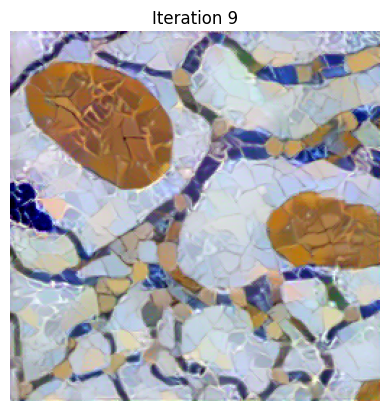

iteration 10
content_loss=261.7218322753906 style_loss=0.007822745479643345
content_loss=260.3593444824219 style_loss=0.008032227866351604
content_loss=261.73095703125 style_loss=0.007731976918876171
content_loss=261.6663818359375 style_loss=0.007698233239352703
content_loss=260.8743591308594 style_loss=0.0077539654448628426
content_loss=261.57073974609375 style_loss=0.007601863704621792
content_loss=261.5618896484375 style_loss=0.007567898835986853
content_loss=260.00201416015625 style_loss=0.008032930083572865
content_loss=261.6249694824219 style_loss=0.007479020860046148
content_loss=261.56597900390625 style_loss=0.007441967725753784
content_loss=260.5052185058594 style_loss=0.007490328047424555
content_loss=261.3284606933594 style_loss=0.007348387036472559
content_loss=261.2452392578125 style_loss=0.007317834533751011
content_loss=260.3028564453125 style_loss=0.0073890164494514465
content_loss=261.184326171875 style_loss=0.007219001650810242
content_loss=261.09564208984375 style_lo

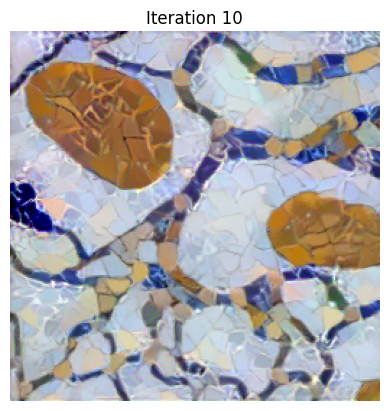

iteration 11
content_loss=260.9040832519531 style_loss=0.006980699487030506
content_loss=260.80023193359375 style_loss=0.006946512497961521
content_loss=259.645263671875 style_loss=0.007020747754722834
content_loss=260.5970458984375 style_loss=0.006869847886264324
content_loss=260.52752685546875 style_loss=0.006842632777988911
content_loss=259.2469787597656 style_loss=0.006993850227445364
content_loss=260.449951171875 style_loss=0.006766383536159992
content_loss=260.3666076660156 style_loss=0.00673773605376482
content_loss=259.32537841796875 style_loss=0.006802198477089405
content_loss=260.1794128417969 style_loss=0.006659404840320349
content_loss=260.1141662597656 style_loss=0.006631971802562475
content_loss=258.6562805175781 style_loss=0.0069826021790504456
content_loss=260.1164245605469 style_loss=0.006561620626598597
content_loss=260.05010986328125 style_loss=0.006532397121191025
content_loss=258.90423583984375 style_loss=0.0066615985706448555
content_loss=259.9501953125 style_loss

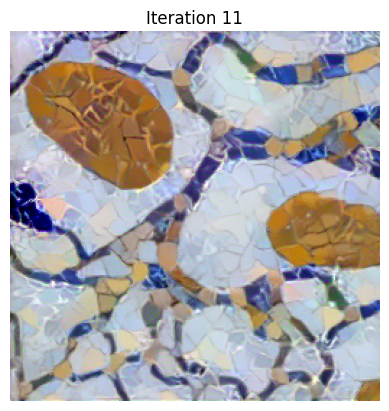

iteration 12
content_loss=259.020751953125 style_loss=0.00638464093208313
content_loss=259.7132873535156 style_loss=0.00626455107703805
content_loss=259.6942443847656 style_loss=0.006240009795874357
content_loss=258.69232177734375 style_loss=0.00635527353733778
content_loss=259.68408203125 style_loss=0.00617049029096961
content_loss=259.63262939453125 style_loss=0.006147319916635752
content_loss=258.67169189453125 style_loss=0.006232645828276873
content_loss=259.4873046875 style_loss=0.006084258668124676
content_loss=259.421875 style_loss=0.006060628220438957
content_loss=258.0153503417969 style_loss=0.006283776368945837
content_loss=259.3197937011719 style_loss=0.006003780290484428
content_loss=259.2226257324219 style_loss=0.005980085581541061
content_loss=258.1698913574219 style_loss=0.0060410937294363976
content_loss=259.00341796875 style_loss=0.005919738207012415
content_loss=258.9255676269531 style_loss=0.00589884165674448
content_loss=257.64068603515625 style_loss=0.0060255550779

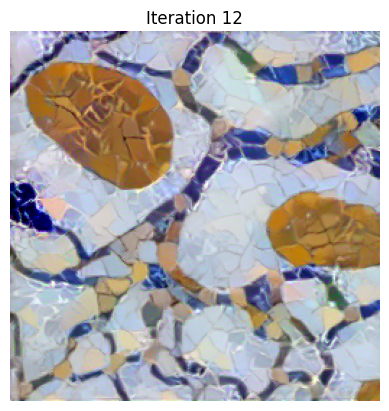

iteration 13
content_loss=258.47711181640625 style_loss=0.005732563324272633
content_loss=257.1429138183594 style_loss=0.005910906940698624
content_loss=258.43701171875 style_loss=0.0056745633482933044
content_loss=258.36138916015625 style_loss=0.005651063751429319
content_loss=257.3543701171875 style_loss=0.005725905764847994
content_loss=258.2152404785156 style_loss=0.005598632153123617
content_loss=258.13824462890625 style_loss=0.0055787404999136925
content_loss=257.1729431152344 style_loss=0.005661291070282459
content_loss=258.05120849609375 style_loss=0.005527828820049763
content_loss=257.9800720214844 style_loss=0.00550872040912509
content_loss=256.96307373046875 style_loss=0.005604079458862543
content_loss=257.8355407714844 style_loss=0.005456072743982077
content_loss=257.7726135253906 style_loss=0.005436265375465155
content_loss=256.42901611328125 style_loss=0.005638523027300835
content_loss=257.6920471191406 style_loss=0.0053870282135903835
content_loss=257.616455078125 style_

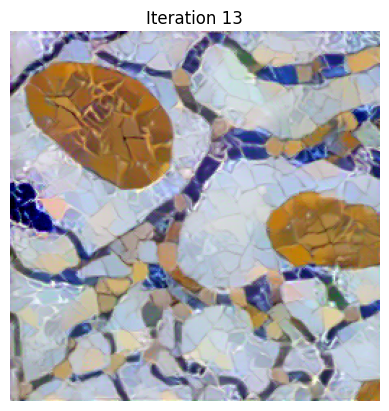

iteration 14
content_loss=257.33575439453125 style_loss=0.005253084935247898
content_loss=257.2711181640625 style_loss=0.005234158132225275
content_loss=256.30279541015625 style_loss=0.005319793242961168
content_loss=257.1481018066406 style_loss=0.0051883808337152
content_loss=257.093017578125 style_loss=0.005170771386474371
content_loss=256.06817626953125 style_loss=0.005309934262186289
content_loss=257.0487976074219 style_loss=0.005123743321746588
content_loss=256.9873046875 style_loss=0.005105291493237019
content_loss=256.02581787109375 style_loss=0.005196604877710342
content_loss=256.8592224121094 style_loss=0.0050597842782735825
content_loss=256.7911071777344 style_loss=0.005041749216616154
content_loss=255.7498779296875 style_loss=0.0051704454235732555
content_loss=256.7189025878906 style_loss=0.004997987300157547
content_loss=256.6517639160156 style_loss=0.004979648161679506
content_loss=255.78591918945312 style_loss=0.005040563642978668
content_loss=256.5130615234375 style_loss

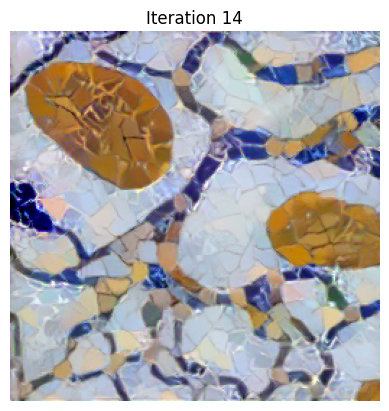

iteration 15
content_loss=255.35572814941406 style_loss=0.004961418453603983
content_loss=256.20623779296875 style_loss=0.004818648565560579
content_loss=256.1332702636719 style_loss=0.004802081733942032
content_loss=255.0198516845703 style_loss=0.004899080842733383
content_loss=256.0117492675781 style_loss=0.004761916119605303
content_loss=255.93405151367188 style_loss=0.00474544009193778
content_loss=255.05975341796875 style_loss=0.004816888831555843
content_loss=255.82119750976562 style_loss=0.004703506361693144
content_loss=255.76126098632812 style_loss=0.004687917418777943
content_loss=254.54702758789062 style_loss=0.004857159219682217
content_loss=255.68026733398438 style_loss=0.004648874513804913
content_loss=255.6104278564453 style_loss=0.0046317861415445805
content_loss=254.67539978027344 style_loss=0.004734390880912542
content_loss=255.51560974121094 style_loss=0.004593122750520706
content_loss=255.45265197753906 style_loss=0.00457705557346344
content_loss=254.46400451660156 

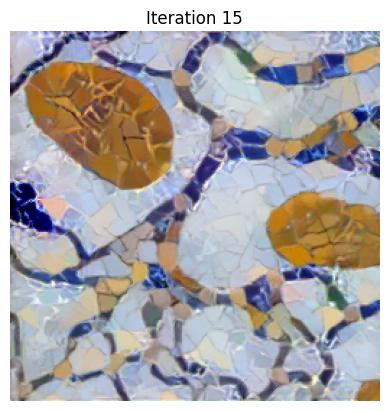

iteration 16
content_loss=255.11483764648438 style_loss=0.004473739769309759
content_loss=254.23233032226562 style_loss=0.004552705679088831
content_loss=255.02894592285156 style_loss=0.004434595815837383
content_loss=254.96585083007812 style_loss=0.004420731216669083
content_loss=254.11965942382812 style_loss=0.00448071863502264
content_loss=254.8515625 style_loss=0.004382561892271042
content_loss=254.7833251953125 style_loss=0.004368497524410486
content_loss=253.77825927734375 style_loss=0.00449188519269228
content_loss=254.72154235839844 style_loss=0.004334216006100178
content_loss=254.64755249023438 style_loss=0.004319118335843086
content_loss=253.7460479736328 style_loss=0.004392644390463829
content_loss=254.5095977783203 style_loss=0.0042861150577664375
content_loss=254.4437713623047 style_loss=0.0042730094864964485
content_loss=253.62660217285156 style_loss=0.004331876523792744
content_loss=254.3613739013672 style_loss=0.004237965680658817
content_loss=254.29150390625 style_loss

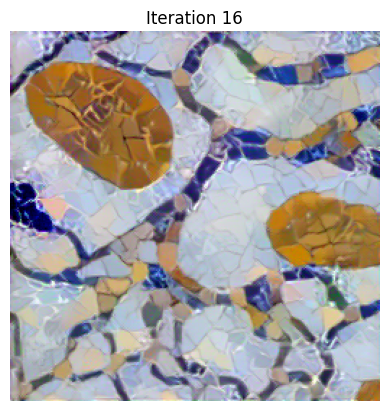

iteration 17
content_loss=254.0338897705078 style_loss=0.004137102514505386
content_loss=253.97518920898438 style_loss=0.004123927094042301
content_loss=253.16653442382812 style_loss=0.0041549429297447205
content_loss=253.81060791015625 style_loss=0.004089429043233395
content_loss=253.7414093017578 style_loss=0.004077239893376827
content_loss=253.01292419433594 style_loss=0.00412735715508461
content_loss=253.65975952148438 style_loss=0.0040436601266264915
content_loss=253.59458923339844 style_loss=0.00403170008212328
content_loss=252.7566680908203 style_loss=0.0040725283324718475
content_loss=253.44754028320312 style_loss=0.0039992788806557655
content_loss=253.37680053710938 style_loss=0.003988062031567097
content_loss=252.58987426757812 style_loss=0.00403496203944087
content_loss=253.2813720703125 style_loss=0.003956405911594629
content_loss=253.2120819091797 style_loss=0.003944925963878632
content_loss=252.38778686523438 style_loss=0.00398686807602644
content_loss=253.08534240722656 

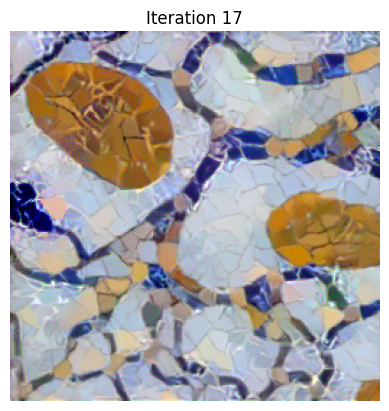

iteration 18
content_loss=252.07305908203125 style_loss=0.0038911071605980396
content_loss=252.70333862304688 style_loss=0.003828647080808878
content_loss=252.6372528076172 style_loss=0.003818151308223605
content_loss=251.6201934814453 style_loss=0.0038887157570570707
content_loss=252.50877380371094 style_loss=0.0037889271043241024
content_loss=252.4267120361328 style_loss=0.0037783465813845396
content_loss=251.65774536132812 style_loss=0.0038095463532954454
content_loss=252.2777099609375 style_loss=0.003748732851818204
content_loss=252.20394897460938 style_loss=0.0037381972651928663
content_loss=251.136962890625 style_loss=0.003827788634225726
content_loss=252.08343505859375 style_loss=0.003710426390171051
content_loss=252.0013427734375 style_loss=0.003699301276355982
content_loss=251.08746337890625 style_loss=0.003748898860067129
content_loss=251.8507080078125 style_loss=0.003672992344945669
content_loss=251.77784729003906 style_loss=0.003663015319034457
content_loss=250.848617553710

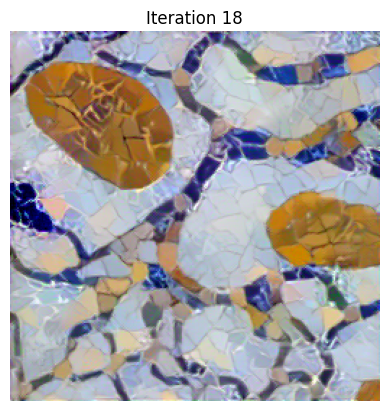

iteration 19
content_loss=251.31044006347656 style_loss=0.0035917293280363083
content_loss=250.2069091796875 style_loss=0.003667648881673813
content_loss=251.15989685058594 style_loss=0.003566375467926264
content_loss=251.06248474121094 style_loss=0.003556532319635153
content_loss=250.12384033203125 style_loss=0.0036018986720591784
content_loss=250.8896484375 style_loss=0.0035311244428157806
content_loss=250.80552673339844 style_loss=0.0035217255353927612
content_loss=249.72593688964844 style_loss=0.003637277754023671
content_loss=250.7211151123047 style_loss=0.003497736994177103
content_loss=250.64764404296875 style_loss=0.003487158566713333
content_loss=249.6634521484375 style_loss=0.003548885229974985
content_loss=250.5081329345703 style_loss=0.0034622843377292156
content_loss=250.43280029296875 style_loss=0.0034522220958024263
content_loss=249.78463745117188 style_loss=0.003475535660982132
content_loss=250.32369995117188 style_loss=0.0034279569517821074
content_loss=250.27258300781

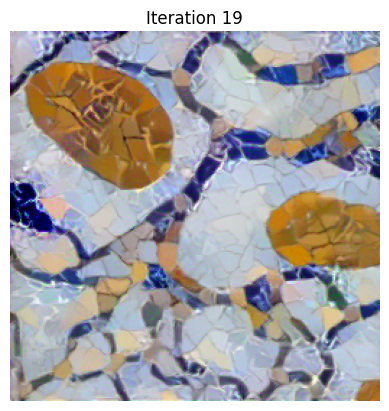

iteration 20
content_loss=249.9984588623047 style_loss=0.0033581298775970936
content_loss=249.9226837158203 style_loss=0.0033498394768685102
content_loss=249.26332092285156 style_loss=0.0033676091115921736
content_loss=249.75662231445312 style_loss=0.0033283215016126633
content_loss=249.68951416015625 style_loss=0.0033207288943231106
content_loss=248.7060546875 style_loss=0.003393597900867462
content_loss=249.57455444335938 style_loss=0.0032989303581416607
content_loss=249.49789428710938 style_loss=0.0032901628874242306
content_loss=248.76255798339844 style_loss=0.003314422443509102
content_loss=249.3459014892578 style_loss=0.00326813873834908
content_loss=249.27581787109375 style_loss=0.0032603528816252947
content_loss=248.50355529785156 style_loss=0.0033008523751050234
content_loss=249.16177368164062 style_loss=0.0032381596975028515
content_loss=249.09262084960938 style_loss=0.0032301503233611584
content_loss=248.34051513671875 style_loss=0.0032521274406462908
content_loss=248.921630

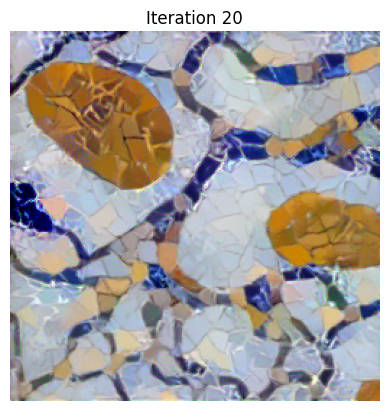

iteration 21
content_loss=247.72607421875 style_loss=0.0032140661496669054
content_loss=248.4650115966797 style_loss=0.003148924559354782
content_loss=248.3853302001953 style_loss=0.003141713095828891
content_loss=247.78738403320312 style_loss=0.0031579986680299044
content_loss=248.23219299316406 style_loss=0.003121007699519396
content_loss=248.1903076171875 style_loss=0.0031140861101448536
content_loss=247.6923065185547 style_loss=0.003121012356132269
content_loss=248.09390258789062 style_loss=0.0030916540417820215
content_loss=248.0691680908203 style_loss=0.0030853988137096167
content_loss=247.56166076660156 style_loss=0.0030984636396169662
content_loss=247.99832153320312 style_loss=0.003058637958019972
content_loss=247.96054077148438 style_loss=0.0030507713090628386
content_loss=247.3042755126953 style_loss=0.0030887830071151257
content_loss=247.87698364257812 style_loss=0.003032282693311572
content_loss=247.82176208496094 style_loss=0.003025972517207265
content_loss=247.392578125 s

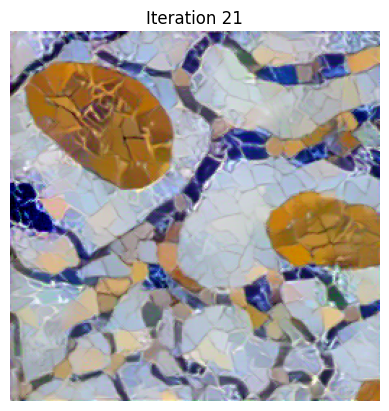

iteration 22
content_loss=247.39215087890625 style_loss=0.0029639839194715023
content_loss=247.05734252929688 style_loss=0.0029611261561512947
content_loss=247.22329711914062 style_loss=0.002950113732367754
content_loss=247.2235870361328 style_loss=0.002943304367363453
content_loss=247.04652404785156 style_loss=0.0029248567298054695
content_loss=247.0067138671875 style_loss=0.0029064093250781298
content_loss=246.6017608642578 style_loss=0.0029031294398009777
content_loss=246.91091918945312 style_loss=0.0028851348906755447
content_loss=246.81419372558594 style_loss=0.002877493854612112
content_loss=246.75927734375 style_loss=0.0028730425983667374
content_loss=246.6526336669922 style_loss=0.002865246031433344
content_loss=246.57260131835938 style_loss=0.0028548077680170536
content_loss=246.27369689941406 style_loss=0.0028457222506403923
content_loss=246.50982666015625 style_loss=0.0028292059432715178
content_loss=246.42214965820312 style_loss=0.0028228857554495335
content_loss=246.259063

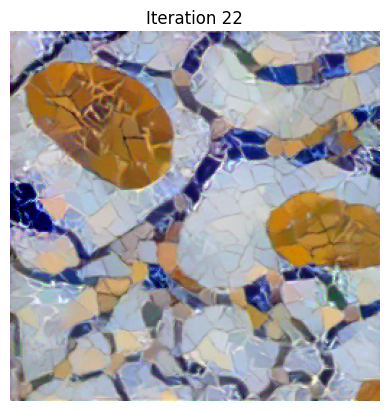

iteration 23
content_loss=246.07325744628906 style_loss=0.0027609835378825665
content_loss=245.85647583007812 style_loss=0.002752223750576377
content_loss=245.7639923095703 style_loss=0.0027464735321700573
content_loss=245.67498779296875 style_loss=0.002738305600360036
content_loss=245.50347900390625 style_loss=0.002728759776800871
content_loss=245.42703247070312 style_loss=0.0027127391658723354
content_loss=245.27737426757812 style_loss=0.0027052494697272778
content_loss=245.338623046875 style_loss=0.002692287787795067
content_loss=245.16259765625 style_loss=0.002688670065253973
content_loss=245.25540161132812 style_loss=0.0026805540546774864
content_loss=245.20506286621094 style_loss=0.0026734969578683376
content_loss=245.02627563476562 style_loss=0.00266369991004467
content_loss=244.91732788085938 style_loss=0.002653716830536723
content_loss=244.69615173339844 style_loss=0.0026378752663731575
content_loss=244.58590698242188 style_loss=0.002629585098475218
content_loss=244.6825103759

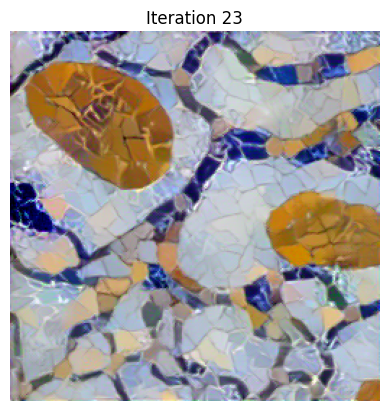

iteration 24
content_loss=244.33746337890625 style_loss=0.002589642535895109
content_loss=244.17735290527344 style_loss=0.002574774669483304
content_loss=244.24790954589844 style_loss=0.002564540132880211
content_loss=244.04495239257812 style_loss=0.0025625028647482395
content_loss=244.11062622070312 style_loss=0.0025557829067111015
content_loss=244.0987091064453 style_loss=0.002547269919887185
content_loss=243.94818115234375 style_loss=0.0025352672673761845
content_loss=243.84925842285156 style_loss=0.002523555886000395
content_loss=243.76858520507812 style_loss=0.002511756494641304
content_loss=243.74964904785156 style_loss=0.002499959198758006
content_loss=243.33389282226562 style_loss=0.0025150009896606207
content_loss=243.66683959960938 style_loss=0.0024882557336241007
content_loss=243.62237548828125 style_loss=0.0024848245084285736
content_loss=243.26528930664062 style_loss=0.0024813488125801086
content_loss=243.4558563232422 style_loss=0.0024690318387001753
content_loss=243.4459

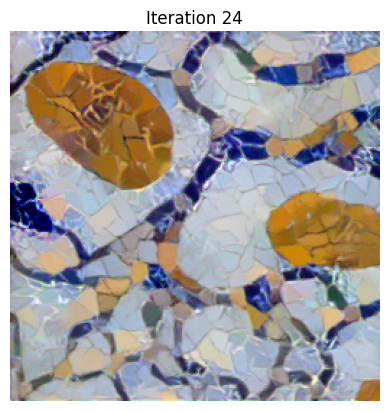

iteration 25
content_loss=243.01083374023438 style_loss=0.00241747684776783
content_loss=243.11654663085938 style_loss=0.002406124724075198
content_loss=243.10302734375 style_loss=0.002400865312665701
content_loss=242.938720703125 style_loss=0.002393395407125354
content_loss=242.97698974609375 style_loss=0.002385364379733801
content_loss=242.87899780273438 style_loss=0.0023778651375323534
content_loss=242.62562561035156 style_loss=0.0023664701730012894
content_loss=242.6876220703125 style_loss=0.0023577564861625433
content_loss=242.5267791748047 style_loss=0.00235348055139184
content_loss=242.4986572265625 style_loss=0.002347292611375451
content_loss=242.4627227783203 style_loss=0.0023376785684376955
content_loss=242.2736053466797 style_loss=0.0023273390252143145
content_loss=242.3212432861328 style_loss=0.0023150790948420763
content_loss=242.00296020507812 style_loss=0.0023205638863146305
content_loss=242.20770263671875 style_loss=0.002307748422026634
content_loss=242.17379760742188 s

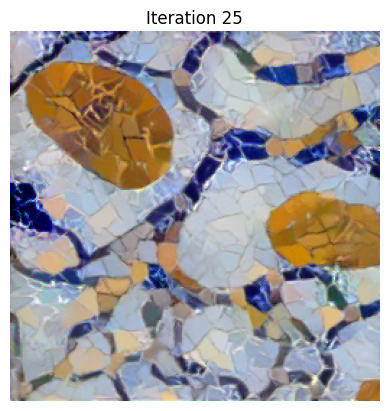

iteration 26
content_loss=241.7613525390625 style_loss=0.0022617639042437077
content_loss=241.67660522460938 style_loss=0.002258208580315113
content_loss=241.5240478515625 style_loss=0.0022504511289298534
content_loss=241.4269256591797 style_loss=0.0022397595457732677
content_loss=241.32537841796875 style_loss=0.0022297780960798264
content_loss=241.26304626464844 style_loss=0.002219200599938631
content_loss=240.98992919921875 style_loss=0.0022216751240193844
content_loss=241.1520233154297 style_loss=0.0022110093850642443
content_loss=241.13491821289062 style_loss=0.0022070645354688168
content_loss=240.9610137939453 style_loss=0.002198143396526575
content_loss=240.9681396484375 style_loss=0.002190230181440711
content_loss=240.88217163085938 style_loss=0.002183609874919057
content_loss=240.8935546875 style_loss=0.002175354864448309
content_loss=240.6918182373047 style_loss=0.0021734219044446945
content_loss=240.8023681640625 style_loss=0.002162880264222622
content_loss=240.77072143554688

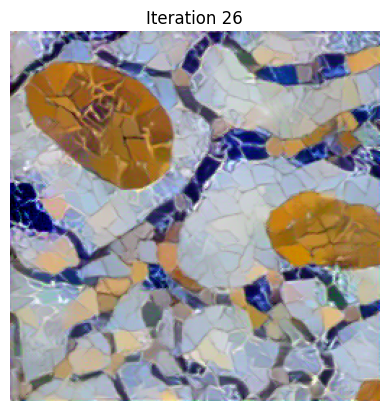

iteration 27
content_loss=240.4652557373047 style_loss=0.002121099503710866
content_loss=240.23423767089844 style_loss=0.002117527648806572
content_loss=240.29595947265625 style_loss=0.0021127555519342422
content_loss=240.2728271484375 style_loss=0.0021075124386698008
content_loss=240.16943359375 style_loss=0.0020988225005567074
content_loss=239.95703125 style_loss=0.0020935949869453907
content_loss=240.03958129882812 style_loss=0.0020840507932007313
content_loss=239.9530792236328 style_loss=0.002080265898257494
content_loss=239.88406372070312 style_loss=0.002075405791401863
content_loss=239.78286743164062 style_loss=0.002065880224108696
content_loss=239.63832092285156 style_loss=0.0020556433591991663
content_loss=239.6382598876953 style_loss=0.002046330366283655
content_loss=239.36581420898438 style_loss=0.0020481967367231846
content_loss=239.49278259277344 style_loss=0.00203954940661788
content_loss=239.45852661132812 style_loss=0.0020363132935017347
content_loss=239.2359161376953 st

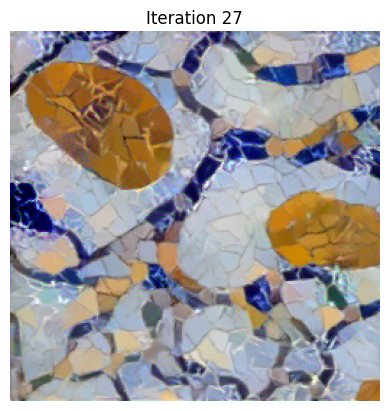

iteration 28
content_loss=239.076904296875 style_loss=0.0019961255602538586
content_loss=238.81167602539062 style_loss=0.0019951940048485994
content_loss=238.92416381835938 style_loss=0.001988093601539731
content_loss=238.88430786132812 style_loss=0.0019852439872920513
content_loss=238.62026977539062 style_loss=0.0019773682579398155
content_loss=238.65951538085938 style_loss=0.001969862263649702
content_loss=238.55747985839844 style_loss=0.001965912524610758
content_loss=238.4943389892578 style_loss=0.0019571278244256973
content_loss=238.3509979248047 style_loss=0.001950601814314723
content_loss=238.46383666992188 style_loss=0.0019447479862719774
content_loss=238.33018493652344 style_loss=0.0019419692689552903
content_loss=238.3331756591797 style_loss=0.0019387288484722376
content_loss=238.19671630859375 style_loss=0.0019297655671834946
content_loss=238.32217407226562 style_loss=0.001923833740875125
content_loss=238.21339416503906 style_loss=0.0019180733943358064
content_loss=238.07649

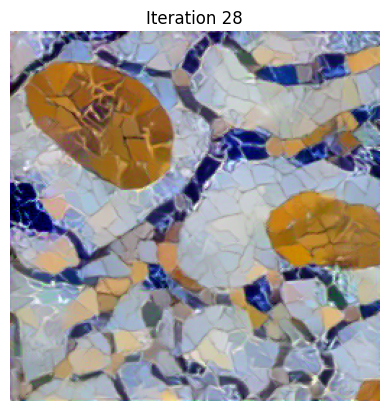

iteration 29
content_loss=237.8218536376953 style_loss=0.0018893794622272253
content_loss=237.619384765625 style_loss=0.0018839609110727906
content_loss=237.5663299560547 style_loss=0.0018780350219458342
content_loss=237.42564392089844 style_loss=0.0018707563867792487
content_loss=237.52255249023438 style_loss=0.0018638039473444223
content_loss=237.3943634033203 style_loss=0.0018624108051881194
content_loss=237.37808227539062 style_loss=0.001859026262536645
content_loss=237.24887084960938 style_loss=0.0018507424974814057
content_loss=237.17242431640625 style_loss=0.0018448177725076675
content_loss=237.07159423828125 style_loss=0.0018391814082860947
content_loss=237.10926818847656 style_loss=0.0018334595952183008
content_loss=236.90365600585938 style_loss=0.0018343186238780618
content_loss=237.0025177001953 style_loss=0.0018292733002454042
content_loss=236.988525390625 style_loss=0.0018270224099978805
content_loss=236.80111694335938 style_loss=0.001819997327402234
content_loss=236.77397

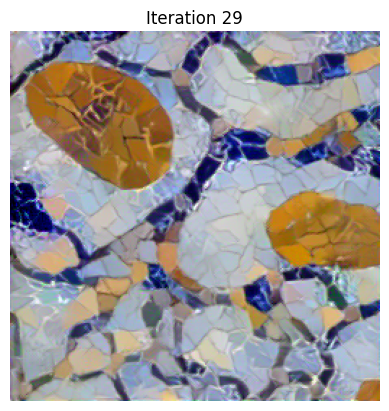

iteration 30
content_loss=236.45550537109375 style_loss=0.0017907324945554137
content_loss=236.2960662841797 style_loss=0.0017836183542385697
content_loss=236.03627014160156 style_loss=0.001780423684976995
content_loss=236.15567016601562 style_loss=0.0017734412103891373
content_loss=236.07972717285156 style_loss=0.0017710147658362985
content_loss=235.99417114257812 style_loss=0.0017687395447865129
content_loss=235.9761199951172 style_loss=0.0017651289235800505
content_loss=235.85205078125 style_loss=0.0017586399335414171
content_loss=235.8763427734375 style_loss=0.0017514710780233145
content_loss=235.69798278808594 style_loss=0.0017483960837125778
content_loss=235.76202392578125 style_loss=0.0017440880183130503
content_loss=235.71925354003906 style_loss=0.0017415881156921387
content_loss=235.6396942138672 style_loss=0.001738398103043437
content_loss=235.64295959472656 style_loss=0.0017352948198094964
content_loss=235.5001678466797 style_loss=0.0017309763934463263
content_loss=235.50242

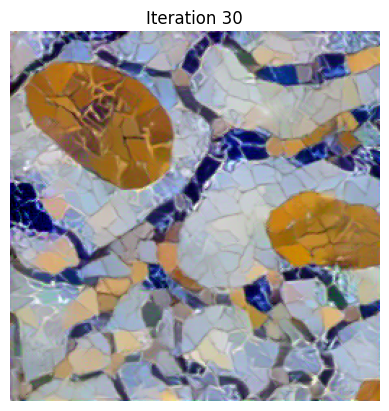

iteration 31
content_loss=235.08908081054688 style_loss=0.0017017762875184417
content_loss=234.96319580078125 style_loss=0.0016992862801998854
content_loss=234.91436767578125 style_loss=0.0016942681977525353
content_loss=234.85011291503906 style_loss=0.0016900546615943313
content_loss=234.78956604003906 style_loss=0.0016843978082761168
content_loss=234.61715698242188 style_loss=0.0016810245579108596
content_loss=234.68417358398438 style_loss=0.0016754765529185534
content_loss=234.5970001220703 style_loss=0.0016727391630411148
content_loss=234.55833435058594 style_loss=0.0016688576433807611
content_loss=234.45631408691406 style_loss=0.0016645699506625533
content_loss=234.43634033203125 style_loss=0.0016591824823990464
content_loss=234.23594665527344 style_loss=0.0016575852641835809
content_loss=234.2819061279297 style_loss=0.0016527412226423621
content_loss=234.25555419921875 style_loss=0.0016494005685672164
content_loss=234.2115020751953 style_loss=0.0016430349787697196
content_loss=23

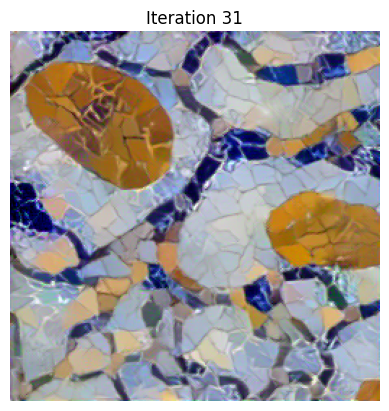

iteration 32
content_loss=233.80882263183594 style_loss=0.0016197673976421356
content_loss=233.78564453125 style_loss=0.0016146022826433182
content_loss=233.63916015625 style_loss=0.0016108195995911956
content_loss=233.6857147216797 style_loss=0.0016051679849624634
content_loss=233.60409545898438 style_loss=0.0016031183768063784
content_loss=233.59925842285156 style_loss=0.0015997167211025953
content_loss=233.5108642578125 style_loss=0.0015953924739733338
content_loss=233.52728271484375 style_loss=0.0015898955753073096
content_loss=233.41522216796875 style_loss=0.0015873415395617485
content_loss=233.3498992919922 style_loss=0.0015835447702556849
content_loss=233.28810119628906 style_loss=0.0015800747787579894
content_loss=233.1662139892578 style_loss=0.0015749884769320488
content_loss=233.00875854492188 style_loss=0.001570977852679789
content_loss=233.09750366210938 style_loss=0.0015658866614103317
content_loss=232.92901611328125 style_loss=0.001564863370731473
content_loss=232.9907073

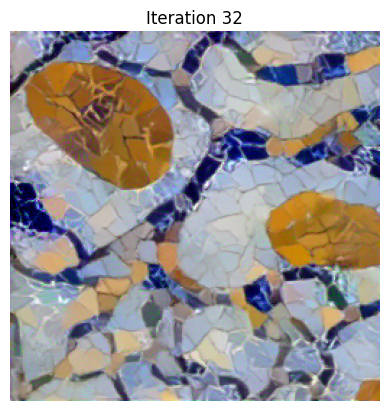

iteration 33
content_loss=232.67333984375 style_loss=0.0015440477291122079
content_loss=232.62924194335938 style_loss=0.0015401067212224007
content_loss=232.523681640625 style_loss=0.0015361469704657793
content_loss=232.5271759033203 style_loss=0.0015305697452276945
content_loss=232.38404846191406 style_loss=0.0015302326064556837
content_loss=232.44847106933594 style_loss=0.0015259095234796405
content_loss=232.41236877441406 style_loss=0.0015239898348227143
content_loss=232.27044677734375 style_loss=0.0015199135523289442
content_loss=232.1956024169922 style_loss=0.0015163717325776815
content_loss=232.10704040527344 style_loss=0.0015135922003537416
content_loss=232.10104370117188 style_loss=0.0015094919363036752
content_loss=231.90048217773438 style_loss=0.0015092696994543076
content_loss=231.98092651367188 style_loss=0.0015040978323668242
content_loss=231.95870971679688 style_loss=0.0015017592813819647
content_loss=231.85240173339844 style_loss=0.0014979956904426217
content_loss=231.77

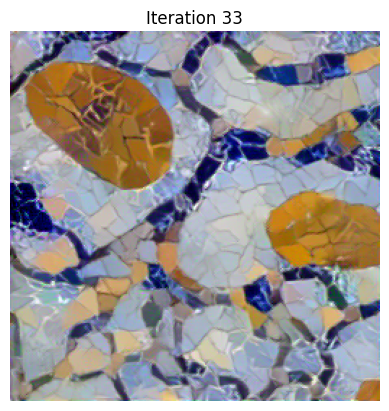

iteration 34
content_loss=231.53041076660156 style_loss=0.0014782686484977603
content_loss=231.5406494140625 style_loss=0.0014757609460502863
content_loss=231.45681762695312 style_loss=0.0014736676821485162
content_loss=231.3618621826172 style_loss=0.0014713077107444406
content_loss=231.3280029296875 style_loss=0.0014679459854960442
content_loss=231.24575805664062 style_loss=0.00146376877091825
content_loss=231.2002716064453 style_loss=0.0014585150638595223
content_loss=231.05218505859375 style_loss=0.0014574714004993439
content_loss=231.10287475585938 style_loss=0.001453419215977192
content_loss=231.04408264160156 style_loss=0.0014514485374093056
content_loss=230.95765686035156 style_loss=0.0014493252383545041
content_loss=230.86761474609375 style_loss=0.0014459065860137343
content_loss=230.73800659179688 style_loss=0.0014437141362577677
content_loss=230.8329620361328 style_loss=0.001439897925592959
content_loss=230.72439575195312 style_loss=0.0014386058319360018
content_loss=230.7311

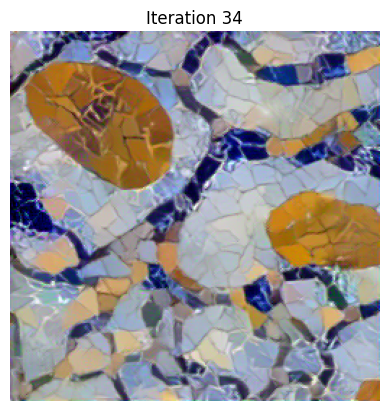

iteration 35
content_loss=230.51939392089844 style_loss=0.0014226834755390882
content_loss=230.4185791015625 style_loss=0.0014216493582352996
content_loss=230.38780212402344 style_loss=0.001419870532117784
content_loss=230.23548889160156 style_loss=0.0014158050762489438
content_loss=230.2320098876953 style_loss=0.0014111537020653486
content_loss=230.08013916015625 style_loss=0.0014105454320088029
content_loss=230.1234588623047 style_loss=0.0014072705525904894
content_loss=230.0889892578125 style_loss=0.0014050217578187585
content_loss=230.00201416015625 style_loss=0.0014005746925249696
content_loss=229.99661254882812 style_loss=0.0013967107515782118
content_loss=229.90013122558594 style_loss=0.001395449973642826
content_loss=229.87986755371094 style_loss=0.001393335172906518
content_loss=229.80259704589844 style_loss=0.0013915825402364135
content_loss=229.78439331054688 style_loss=0.00138773990329355
content_loss=229.68821716308594 style_loss=0.0013852107804268599
content_loss=229.7032

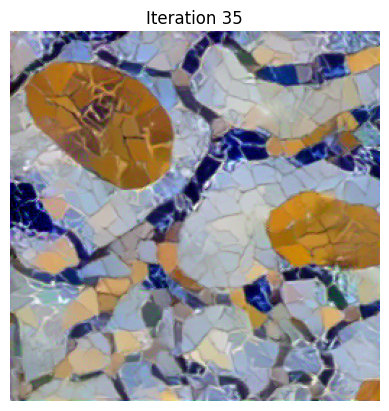

iteration 36
content_loss=229.2860565185547 style_loss=0.0013673664070665836
content_loss=229.3535614013672 style_loss=0.0013649363536387682
content_loss=229.1954345703125 style_loss=0.0013642108533531427
content_loss=229.21694946289062 style_loss=0.001362488605082035
content_loss=229.19650268554688 style_loss=0.0013606796273961663
content_loss=229.11581420898438 style_loss=0.0013578672660514712
content_loss=228.99346923828125 style_loss=0.0013564808759838343
content_loss=229.01467895507812 style_loss=0.0013524845708161592
content_loss=228.90328979492188 style_loss=0.0013514556922018528
content_loss=228.87986755371094 style_loss=0.0013497162144631147
content_loss=228.80905151367188 style_loss=0.001347580924630165
content_loss=228.73948669433594 style_loss=0.0013439778704196215
content_loss=228.68260192871094 style_loss=0.0013414070708677173
content_loss=228.7420654296875 style_loss=0.0013381224125623703
content_loss=228.60081481933594 style_loss=0.0013380456948652864
content_loss=228.6

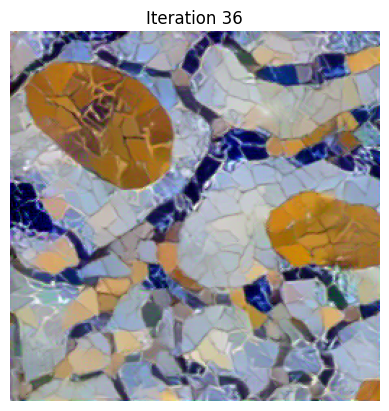

iteration 37
content_loss=228.3194580078125 style_loss=0.0013236751547083259
content_loss=228.34288024902344 style_loss=0.0013208668678998947
content_loss=228.28347778320312 style_loss=0.0013190826866775751
content_loss=228.13565063476562 style_loss=0.0013162128161638975
content_loss=228.16419982910156 style_loss=0.001313521177507937
content_loss=228.10736083984375 style_loss=0.0013122956734150648
content_loss=228.08685302734375 style_loss=0.001310325926169753
content_loss=228.07376098632812 style_loss=0.0013084386009722948
content_loss=227.96824645996094 style_loss=0.0013048633700236678
content_loss=227.9325408935547 style_loss=0.0013021437916904688
content_loss=227.81459045410156 style_loss=0.0013009249232709408
content_loss=227.84434509277344 style_loss=0.0012986998772248626
content_loss=227.7984619140625 style_loss=0.0012976747239008546
content_loss=227.68853759765625 style_loss=0.0012958698207512498
content_loss=227.69476318359375 style_loss=0.001293625682592392
content_loss=227.6

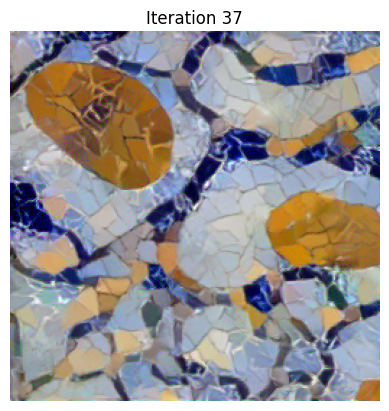

iteration 38
content_loss=227.31137084960938 style_loss=0.0012785166036337614
content_loss=227.2803497314453 style_loss=0.0012757822405546904
content_loss=227.21490478515625 style_loss=0.001274620182812214
content_loss=227.2344207763672 style_loss=0.0012718725483864546
content_loss=227.14398193359375 style_loss=0.0012708294671028852
content_loss=227.1624298095703 style_loss=0.001268382533453405
content_loss=227.1242218017578 style_loss=0.0012666697148233652
content_loss=227.06455993652344 style_loss=0.0012646493269130588
content_loss=226.96453857421875 style_loss=0.0012620355701074004
content_loss=226.8958740234375 style_loss=0.00125912728253752
content_loss=226.85646057128906 style_loss=0.0012573323911055923
content_loss=226.8178253173828 style_loss=0.0012552605476230383
content_loss=226.7105712890625 style_loss=0.0012533580884337425
content_loss=226.77862548828125 style_loss=0.0012510695960372686
content_loss=226.660888671875 style_loss=0.0012499891454353929
content_loss=226.67724609

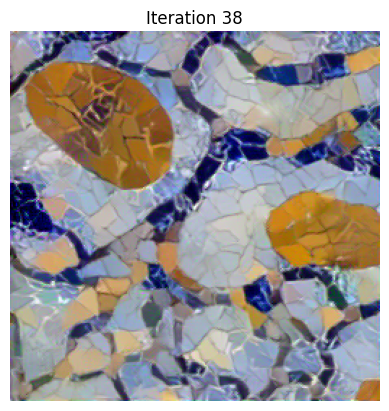

iteration 39
content_loss=226.44923400878906 style_loss=0.0012364921858534217
content_loss=226.34303283691406 style_loss=0.0012362620327621698
content_loss=226.32269287109375 style_loss=0.001234880997799337
content_loss=226.2828369140625 style_loss=0.0012334224302321672
content_loss=226.16604614257812 style_loss=0.0012307355646044016
content_loss=226.16725158691406 style_loss=0.0012278134236112237
content_loss=226.10546875 style_loss=0.0012267223792150617
content_loss=226.113037109375 style_loss=0.001224445877596736
content_loss=226.03404235839844 style_loss=0.0012231010477989912
content_loss=225.96929931640625 style_loss=0.0012206023093312979
content_loss=225.85714721679688 style_loss=0.0012198429321870208
content_loss=225.8502960205078 style_loss=0.0012178390752524137
content_loss=225.80787658691406 style_loss=0.001216347562149167
content_loss=225.76564025878906 style_loss=0.0012132551055401564
content_loss=225.7516632080078 style_loss=0.0012109053786844015
content_loss=225.733642578

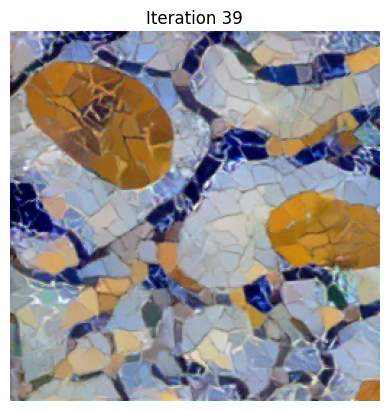

iteration 40
content_loss=225.54644775390625 style_loss=0.001202738145366311
content_loss=225.39642333984375 style_loss=0.001201170263811946
content_loss=225.4112091064453 style_loss=0.0011990147177129984
content_loss=225.35707092285156 style_loss=0.0011973758228123188
content_loss=225.30189514160156 style_loss=0.0011946683516725898
content_loss=225.18914794921875 style_loss=0.0011940564727410674
content_loss=225.26951599121094 style_loss=0.0011918937088921666
content_loss=225.23361206054688 style_loss=0.001191016286611557
content_loss=225.16748046875 style_loss=0.0011903721606358886
content_loss=225.1496124267578 style_loss=0.0011893149930983782
content_loss=225.0719757080078 style_loss=0.0011870779562741518
content_loss=225.0513916015625 style_loss=0.0011841244995594025
content_loss=224.96380615234375 style_loss=0.0011828795541077852
content_loss=224.984130859375 style_loss=0.0011809992138296366
content_loss=224.92172241210938 style_loss=0.0011803023517131805
content_loss=224.9112548

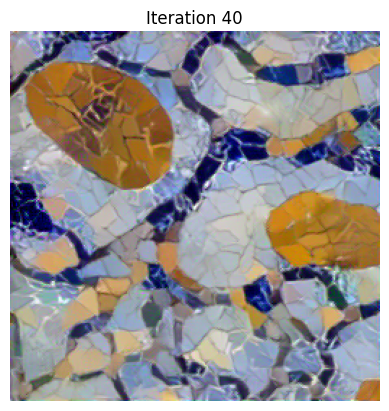

iteration 41
content_loss=224.6748504638672 style_loss=0.0011710047256201506
content_loss=224.61512756347656 style_loss=0.001168514252640307
content_loss=224.53829956054688 style_loss=0.0011668086517602205
content_loss=224.52447509765625 style_loss=0.001165212830528617
content_loss=224.4951171875 style_loss=0.0011629970977082849
content_loss=224.35906982421875 style_loss=0.001162987551651895
content_loss=224.3858184814453 style_loss=0.001160184619948268
content_loss=224.35574340820312 style_loss=0.001158854691311717
content_loss=224.2828369140625 style_loss=0.00115798634942621
content_loss=224.28851318359375 style_loss=0.0011562807485461235
content_loss=224.2120819091797 style_loss=0.0011550246272236109
content_loss=224.17982482910156 style_loss=0.001152783865109086
content_loss=224.12405395507812 style_loss=0.0011502293637022376
content_loss=224.02601623535156 style_loss=0.0011481508845463395
content_loss=223.98802185058594 style_loss=0.0011465048883110285
content_loss=224.0400390625 

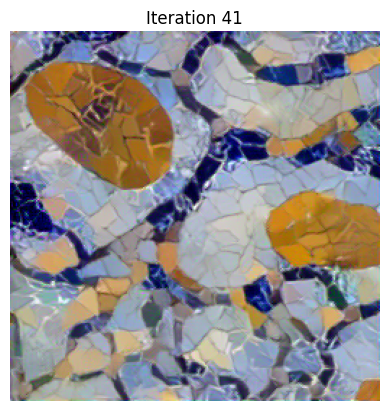

iteration 42
content_loss=223.78184509277344 style_loss=0.0011385915568098426
content_loss=223.8065948486328 style_loss=0.0011361248325556517
content_loss=223.73175048828125 style_loss=0.0011356670875102282
content_loss=223.70379638671875 style_loss=0.0011345244711264968
content_loss=223.6314239501953 style_loss=0.0011327533284202218
content_loss=223.56362915039062 style_loss=0.0011309701949357986
content_loss=223.51553344726562 style_loss=0.001129021169617772
content_loss=223.47283935546875 style_loss=0.0011278733145445585
content_loss=223.4519805908203 style_loss=0.001125748036429286
content_loss=223.27633666992188 style_loss=0.001127620809711516
content_loss=223.36663818359375 style_loss=0.001124340109527111
content_loss=223.35305786132812 style_loss=0.0011236157733947039
content_loss=223.27723693847656 style_loss=0.0011221534805372357
content_loss=223.16635131835938 style_loss=0.0011204080656170845
content_loss=223.0992431640625 style_loss=0.0011183680035173893
content_loss=223.124

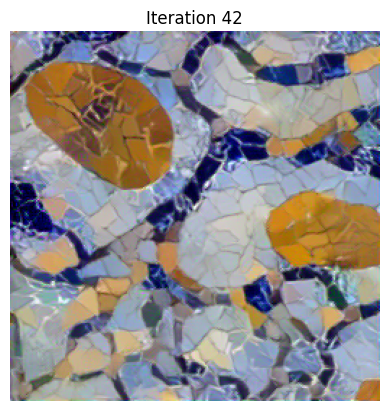

iteration 43
content_loss=222.8522491455078 style_loss=0.0011104561854153872
content_loss=222.8223114013672 style_loss=0.0011092761997133493
content_loss=222.78488159179688 style_loss=0.001107495161704719
content_loss=222.67105102539062 style_loss=0.001108179334551096
content_loss=222.73486328125 style_loss=0.001105529023334384
content_loss=222.72434997558594 style_loss=0.0011046432191506028
content_loss=222.66482543945312 style_loss=0.0011033574119210243
content_loss=222.6374969482422 style_loss=0.001101569039747119
content_loss=222.54444885253906 style_loss=0.0011001914972439408
content_loss=222.57215881347656 style_loss=0.001098321401514113
content_loss=222.51568603515625 style_loss=0.0010979129001498222
content_loss=222.47195434570312 style_loss=0.001096965279430151
content_loss=222.4119110107422 style_loss=0.0010954419849440455
content_loss=222.38485717773438 style_loss=0.00109332543797791
content_loss=222.2832794189453 style_loss=0.0010927869006991386
content_loss=222.33311462402

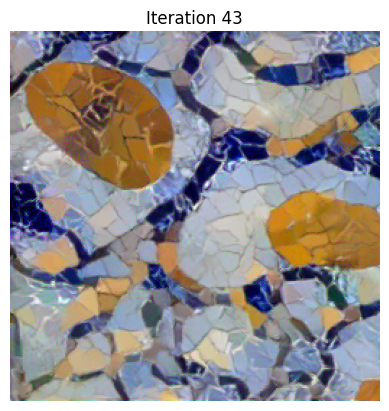

iteration 44
content_loss=222.18238830566406 style_loss=0.0010849672835320234
content_loss=222.11203002929688 style_loss=0.0010845994111150503
content_loss=222.0931396484375 style_loss=0.0010836509754881263
content_loss=222.04747009277344 style_loss=0.0010819925228133798
content_loss=221.96917724609375 style_loss=0.0010809415252879262
content_loss=221.95753479003906 style_loss=0.0010791043750941753
content_loss=221.90687561035156 style_loss=0.0010779972653836012
content_loss=221.88137817382812 style_loss=0.0010762409074231982
content_loss=221.77389526367188 style_loss=0.0010764030739665031
content_loss=221.79879760742188 style_loss=0.0010745131876319647
content_loss=221.777587890625 style_loss=0.0010735738324001431
content_loss=221.7332000732422 style_loss=0.0010722496081143618
content_loss=221.63897705078125 style_loss=0.001071216887794435
content_loss=221.64291381835938 style_loss=0.0010692011564970016
content_loss=221.5794219970703 style_loss=0.0010685859015211463
content_loss=221.5

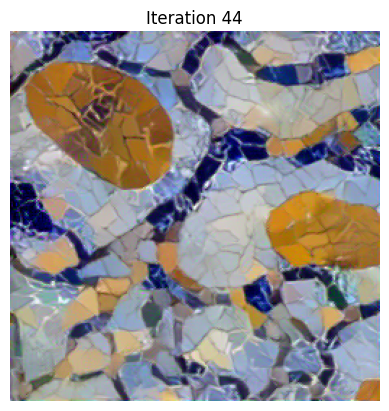

iteration 45
content_loss=221.36148071289062 style_loss=0.0010621026158332825
content_loss=221.3421630859375 style_loss=0.0010606007417663932
content_loss=221.28402709960938 style_loss=0.0010601028334349394
content_loss=221.27288818359375 style_loss=0.0010588453151285648
content_loss=221.1977996826172 style_loss=0.0010581024689599872
content_loss=221.1683349609375 style_loss=0.0010564965195953846
content_loss=221.10525512695312 style_loss=0.0010555250337347388
content_loss=221.08929443359375 style_loss=0.0010537465568631887
content_loss=221.0264434814453 style_loss=0.0010532238520681858
content_loss=221.0032958984375 style_loss=0.0010517581831663847
content_loss=220.94012451171875 style_loss=0.001050809514708817
content_loss=220.94534301757812 style_loss=0.001049067359417677
content_loss=220.87977600097656 style_loss=0.001048643491230905
content_loss=220.86679077148438 style_loss=0.0010476118186488748
content_loss=220.81692504882812 style_loss=0.0010466634994372725
content_loss=220.757

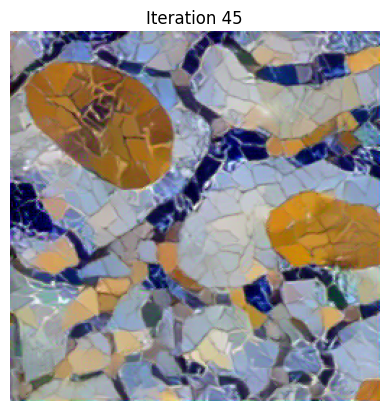

iteration 46
content_loss=220.6167755126953 style_loss=0.0010407946538180113
content_loss=220.61045837402344 style_loss=0.001039965427480638
content_loss=220.5660858154297 style_loss=0.0010389735689386725
content_loss=220.48126220703125 style_loss=0.0010375010315328836
content_loss=220.45867919921875 style_loss=0.0010360621381551027
content_loss=220.4372100830078 style_loss=0.0010350178927183151
content_loss=220.4093475341797 style_loss=0.001033562934026122
content_loss=220.311279296875 style_loss=0.0010328259086236358
content_loss=220.32275390625 style_loss=0.0010309896897524595
content_loss=220.234130859375 style_loss=0.0010309919016435742
content_loss=220.2255096435547 style_loss=0.0010302357841283083
content_loss=220.20059204101562 style_loss=0.0010292166844010353
content_loss=220.13818359375 style_loss=0.0010280192364007235
content_loss=220.0749053955078 style_loss=0.001027233200147748
content_loss=220.12094116210938 style_loss=0.0010255415691062808
content_loss=220.05764770507812

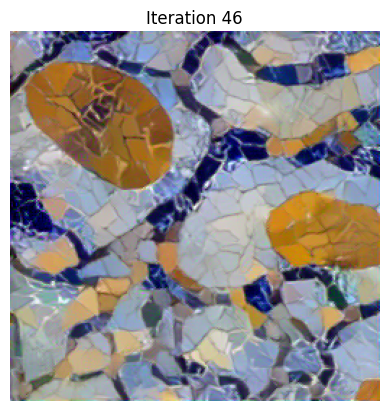

iteration 47
content_loss=219.9244842529297 style_loss=0.0010195707436650991
content_loss=219.84237670898438 style_loss=0.001019625342451036
content_loss=219.867431640625 style_loss=0.0010184550192207098
content_loss=219.85671997070312 style_loss=0.0010177515214309096
content_loss=219.79415893554688 style_loss=0.0010165905114263296
content_loss=219.7490234375 style_loss=0.0010152623290196061
content_loss=219.6732177734375 style_loss=0.001014010631479323
content_loss=219.6983184814453 style_loss=0.0010125444969162345
content_loss=219.63214111328125 style_loss=0.0010124456603080034
content_loss=219.63206481933594 style_loss=0.0010117022320628166
content_loss=219.591064453125 style_loss=0.0010103173553943634
content_loss=219.54298400878906 style_loss=0.0010093357414007187
content_loss=219.481201171875 style_loss=0.001008514896966517
content_loss=219.50146484375 style_loss=0.0010070347925648093
content_loss=219.41551208496094 style_loss=0.0010072162840515375
content_loss=219.43638610839844

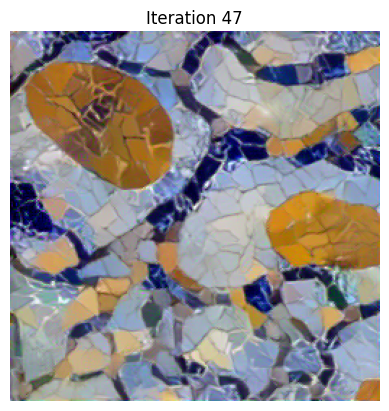

iteration 48
content_loss=219.27056884765625 style_loss=0.0010008045937865973
content_loss=219.17164611816406 style_loss=0.0010010851547122002
content_loss=219.20631408691406 style_loss=0.0009998449822887778
content_loss=219.19761657714844 style_loss=0.0009991924744099379
content_loss=219.1406707763672 style_loss=0.000998208997771144
content_loss=219.1070098876953 style_loss=0.000997166964225471
content_loss=219.0255584716797 style_loss=0.0009959391318261623
content_loss=219.01345825195312 style_loss=0.0009945526253432035
content_loss=218.97547912597656 style_loss=0.0009939117589965463
content_loss=218.9578857421875 style_loss=0.0009930416708812118
content_loss=218.865234375 style_loss=0.00099318812135607
content_loss=218.87649536132812 style_loss=0.0009918746072798967
content_loss=218.85548400878906 style_loss=0.0009911697125062346
content_loss=218.7957305908203 style_loss=0.0009901446755975485
content_loss=218.78012084960938 style_loss=0.000988868298009038
content_loss=218.7413940429

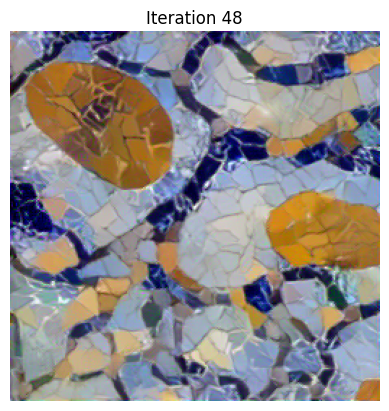

iteration 49
content_loss=218.57420349121094 style_loss=0.0009843080770224333
content_loss=218.52621459960938 style_loss=0.0009830233175307512
content_loss=218.479736328125 style_loss=0.0009820971172302961
content_loss=218.49319458007812 style_loss=0.0009808782488107681
content_loss=218.3976287841797 style_loss=0.0009813981596380472
content_loss=218.43324279785156 style_loss=0.0009801106061786413
content_loss=218.42440795898438 style_loss=0.0009794501820579171
content_loss=218.37510681152344 style_loss=0.0009787356248125434
content_loss=218.30532836914062 style_loss=0.0009778037201613188
content_loss=218.24493408203125 style_loss=0.0009768137242645025
content_loss=218.192138671875 style_loss=0.0009761013789102435
content_loss=218.22616577148438 style_loss=0.0009749691816978157
content_loss=218.16981506347656 style_loss=0.000974798749666661
content_loss=218.1610870361328 style_loss=0.0009742192924022675
content_loss=218.11602783203125 style_loss=0.0009732398902997375
content_loss=218.08

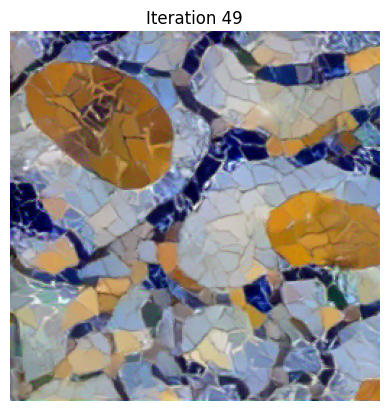

In [12]:
style_transfer(
    image=content, content=content, style=style,
    content_layers=[model.features[l] for l in [14]],
    style_layers=[model.features[l] for l in [0, 2, 5, 7, 10]],
    lr=1, iter_num=50, beta=1e5,
)